In [1]:
import torch
import torch.optim as optim
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import sklearn
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import csv
import math
import scipy

import dataset
import datasplit
import model.models as models
import trainer
import utils

# TEST on MONO

In [2]:
# folders
models_folder = '../../saved/models'
model_name = '20201017_setnetcond_tanh_mono_best'
results_folder = '../../saved/results'
results_subfolder = '20201017_setnetcond_tanh_mono'

# load model
setnetcond = torch.load('%s/%s' % (models_folder, model_name), map_location=torch.device('cpu'))

# load results
all_train_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_train_losses.npy')), allow_pickle=True)
all_train_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_train_correct.npy')), allow_pickle=True)
best_train_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_train_results.npy')), allow_pickle=True)

all_val_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_val_losses.npy')), allow_pickle=True)
all_val_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_val_correct.npy')), allow_pickle=True)
best_val_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_val_results.npy')), allow_pickle=True)

all_test_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_test_losses.npy')), allow_pickle=True)
all_test_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_test_correct.npy')), allow_pickle=True)
best_test_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_test_results.npy')), allow_pickle=True)

fx_labels = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'fx_labels.npy')), allow_pickle=True)

# datasets sizes
train_set_size = best_train_results.shape[0]
val_set_size = best_val_results.shape[0]
test_set_size = best_test_results.shape[0]

# example
best_train_results[0]

array([51073, 'G63-65410-DS1-D2T10-20720',
       array([1.   , 0.211, 0.998], dtype=float32),
       array([1. , 0.2, 1. ], dtype=float32)], dtype=object)

In [3]:
# # BEST RESULTS
# print('Best Train Accuracy: ', 100 * max(all_train_correct) / train_set_size)
# print('Epoch: ', np.argmax(all_train_correct))
# print()
# print('Best Val Accuracy: ', 100 * max(all_val_correct) / val_set_size)
# print('Epoch: ', np.argmax(all_val_correct))
# print()
# print('Best Test Accuracy: ', 100 * max(all_test_correct) / test_set_size)
# print('Epoch: ', np.argmax(all_test_correct))
# print()

In [4]:
# Find best performance epoch based on validation
# Extract results from training and test for that epoch
best_val = 100 * max(all_val_correct) / val_set_size
best_val_idx = np.argmax(all_val_correct)

print("Best Validation Accuracy: ",best_val, "at epoch ", best_val_idx)
print("Training Accuracy: ", 100 * all_train_correct[best_val_idx] / train_set_size)
print("Test Accuracy: ", 100 * all_test_correct[best_val_idx] / test_set_size)

Best Validation Accuracy:  80.09104704097116 at epoch  95
Training Accuracy:  92.74697603309501
Test Accuracy:  80.05746428715956


In [5]:
# # LOSS
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, all_train_losses, 'b', label='Train loss')
# plt.plot(epochs, all_val_losses, 'r', label='Validation loss')
# plt.plot(epochs, all_test_losses, 'g', label='Test loss')
# plt.title('Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

In [6]:
# # NORMALISED LOSS
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, np.array(all_train_losses) / max(all_train_losses), 'b', label='Train loss')
# plt.plot(epochs, np.array(all_val_losses) / max(all_val_losses), 'r', label='Validation loss')
# plt.plot(epochs, np.array(all_test_losses) / max(all_test_losses), 'g', label='Test loss')
# plt.title('Normalised Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

In [7]:
# # ACCURACY
# all_train_perc_correct = 100 * np.array(all_train_correct) / train_set_size
# all_val_perc_correct = 100 * np.array(all_val_correct) / val_set_size
# all_test_perc_correct = 100 * np.array(all_test_correct) / test_set_size
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, all_train_perc_correct, 'b', label='Train acc')
# plt.plot(epochs, all_val_perc_correct, 'r', label='Validation acc')
# plt.plot(epochs, all_test_perc_correct, 'g', label='Test acc')
# plt.title('Accuracy')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

In [8]:
# dataframes
test_indexes_mono = best_test_results[:, 0]
test_filenames_mono = best_test_results[:, 1] 
test_preds_mono = np.stack(best_test_results[:, 2])
test_targets_mono = np.stack(best_test_results[:, 3])
test_abs_err_mono = np.stack(abs(test_preds_mono - test_targets_mono))
test_err_mono = np.stack(test_preds_mono - test_targets_mono)

# dataframes
test_df_mono = pd.DataFrame(data={
                                'index': test_indexes_mono, 
                                'filename': test_filenames_mono,
                                'level_pred': test_preds_mono[:,0], 
                                'gain_pred': test_preds_mono[:,1],
                                'tone_eq1_pred': test_preds_mono[:,2], 
                                'level_targ': test_targets_mono[:,0], 
                                'gain_targ': test_targets_mono[:,1],
                                'tone_eq1_targ': test_targets_mono[:,2], 
                                'level_err': test_err_mono[:,0], 
                                'gain_err': test_err_mono[:,1],
                                'tone_eq1_err': test_err_mono[:,2], 
                                'level_abs': test_abs_err_mono[:,0], 
                                'gain_abs': test_abs_err_mono[:,1],
                                'tone_eq1_abs': test_abs_err_mono[:,2], 
                                })
print(len(test_df_mono))
test_df_mono[:3]

24711


,index,filename,level_pred,gain_pred,tone_eq1_pred,level_targ,gain_targ,tone_eq1_targ,level_err,gain_err,tone_eq1_err,level_abs,gain_abs,tone_eq1_abs
0,38562,G93-61406-DPL-D5-21184,1.0,0.501,-1.000,1.0,0.5,-1.0,0.0,0.001,0.000,0.0,0.001,0.000
1,11551,G93-66411-808-O5T0-21189,1.0,0.501,0.011,1.0,0.5,0.0,0.0,0.001,0.011,0.0,0.001,0.011
2,6159,G91-55305-808-O2T2-21092,1.0,0.207,0.219,1.0,0.2,0.2,0.0,0.007,0.019,0.0,0.007,0.019


In [9]:
# Mean Absolute Errors
level_mae_mono = sum(test_df_mono.level_abs)/test_set_size
gain_mae_mono = sum(test_df_mono.gain_abs)/test_set_size
tone_eq1_mae_mono = sum(test_df_mono.tone_eq1_abs)/test_set_size

print('level_mae: ', level_mae_mono)
print('gain_mae: ', gain_mae_mono)
print('tone_eq1_mae: ', tone_eq1_mae_mono)

# Root Mean Squared Errors
level_rmse_mono = math.sqrt(sum(test_df_mono.level_abs**2)/test_set_size)
gain_rmse_mono = math.sqrt(sum(test_df_mono.gain_abs**2)/test_set_size)
tone_eq1_rmse_mono = math.sqrt(sum(test_df_mono.tone_eq1_abs**2)/test_set_size)

print('level_rmse: ', level_rmse_mono)
print('gain_rmse: ', gain_rmse_mono)
print('tone_eq1_rmse: ', tone_eq1_rmse_mono)

level_mae:  0.0
gain_mae:  0.029632429400476494
tone_eq1_mae:  0.03915009479942133
level_rmse:  0.0
gain_rmse:  0.0605182103644449
tone_eq1_rmse:  0.06996963730126461


[(-0.22, 0.22)]

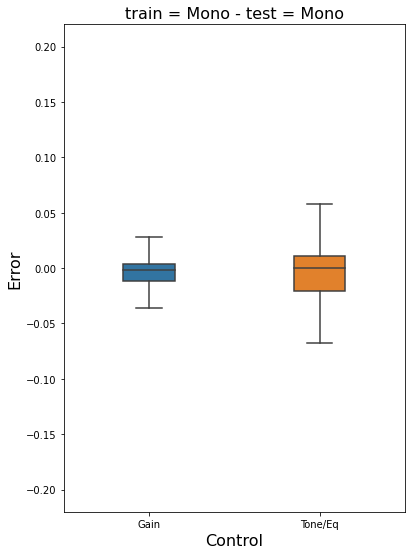

In [10]:
# box plot
err_df_mono = pd.DataFrame(data={
                        'Gain': test_df_mono['gain_err'],
                        'Tone/Eq': test_df_mono['tone_eq1_err'],
                        })

plt.figure(figsize=(6,8))
ax = sns.boxplot(x="variable", y="value", data=pd.melt(err_df_mono), width=0.3, showfliers = False, fliersize=2)

plt.title('train = Mono - test = Mono', fontsize=16)

plt.xlabel('Control', fontsize=16)
plt.ylabel('Error', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('font', size=16) 

plt.tight_layout()
ax.set(ylim=(-0.22,0.22))
# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_mono_mono_bp.eps'), format='eps')

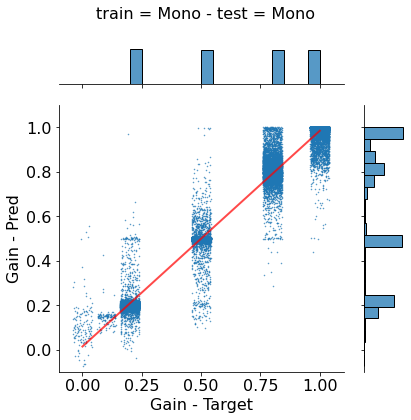

In [33]:
# scatter plot
ax = sns.jointplot(x="gain_targ", y="gain_pred", data=test_df_mono, marker='.', x_jitter=0.04, kind="reg", space=0.1,
                    scatter_kws={"s": 1}, 
                    line_kws={"color":"r","alpha":0.7,"lw":2},
                    marginal_kws=dict(kde=False, bins=20))

ax.fig.suptitle('train = Mono - test = Mono', fontsize=16)

plt.xlabel('Gain - Target', fontsize=16)
plt.ylabel('Gain - Pred', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

# plt.plot([0, 1], [0, 1], 'k:', lw=2)

ax.fig.tight_layout()
ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_mono_mono_gain_sp.png'), format='png')

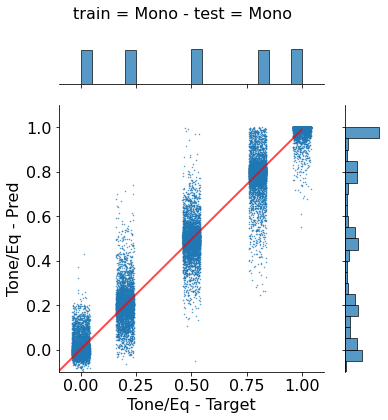

In [34]:
# scatter plot
ax = sns.jointplot(x="tone_eq1_targ", y="tone_eq1_pred", data=test_df_mono, marker='.', x_jitter=0.04, kind="reg", space=0.1,
                    scatter_kws={"s": 1}, 
                    line_kws={"color":"r","alpha":0.7,"lw":2},
                    marginal_kws=dict(kde=False, bins=40))

ax.fig.suptitle('train = Mono - test = Mono', fontsize=16)

plt.xlabel('Tone/Eq - Target', fontsize=16)
plt.ylabel('Tone/Eq - Pred', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

# plt.plot([0, 1], [0, 1], 'k:', lw=2)

ax.fig.tight_layout()
ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_mono_mono_tone_sp.png'), format='png')

[ 0.114  0.044  0.002 -0.006  0.012 -0.029]
[ 0.014  0.002 -0.006 -0.013 -0.013]


(-0.15, 0.15)

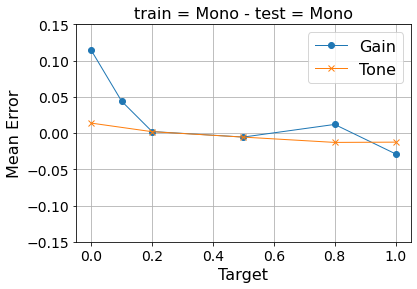

In [13]:
# mean error plot
steps_gain = [0.0, 0.1, 0.2, 0.5, 0.8, 1.0]
steps_tone = [0.0, 0.2, 0.5, 0.8, 1.0]
avg_err_gain = []
avg_err_tone = []

for n in range(len(steps_gain)):
    df = test_df_mono[test_df_mono['gain_targ'] == steps_gain[n]]
    avg_err_gain.append(sum(df['gain_err']) / len(df))

for n in range(len(steps_tone)):
    df = test_df_mono[test_df_mono['tone_eq1_targ'] == steps_tone[n]]
    avg_err_tone.append(sum(df['tone_eq1_err']) / len(df))

print(np.around(avg_err_gain,3))
print(np.around(avg_err_tone,3))

plt.plot(steps_gain, avg_err_gain, linestyle='-', linewidth=1, marker='o')
plt.plot(steps_tone, avg_err_tone, linestyle='-', linewidth=1, marker='x')

plt.title('train = Mono - test = Mono', fontsize=16)

plt.xlabel('Target', fontsize=16)
plt.ylabel('Mean Error', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

plt.legend(['Gain', 'Tone'])

plt.xticks(np.linspace(start=0, stop=1, num=6))
# plt.plot([0, 1], [0, 0], 'k--', lw=1)

plt.xlim([-0.05, 1.05])
plt.ylim([-0.15, 0.15])

[ 1.772  3.476  4.762 -1.268 -0.568 -3.054]
[ 1.674  1.086  0.232 -1.348 -4.914]


(-0.05, 1.05)

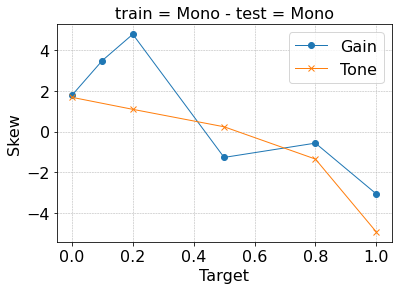

In [14]:
# skew plot
steps_gain = [0.0, 0.1, 0.2, 0.5, 0.8, 1.0]
steps_tone = [0.0, 0.2, 0.5, 0.8, 1.0]
skew_gain = []
skew_tone = []

for n in range(len(steps_gain)):
    df = test_df_mono[test_df_mono['gain_targ'] == steps_gain[n]]
    skew_gain.append(scipy.stats.skew(df['gain_err']))

for n in range(len(steps_tone)):
    df = test_df_mono[test_df_mono['tone_eq1_targ'] == steps_tone[n]]
    skew_tone.append(scipy.stats.skew(df['tone_eq1_err']))

print(np.around(skew_gain,3))
print(np.around(skew_tone,3))

plt.plot(steps_gain, skew_gain, linestyle='-', linewidth=1, marker='o')
plt.plot(steps_tone, skew_tone, linestyle='-', linewidth=1, marker='x')

plt.title('train = Mono - test = Mono', fontsize=16)

plt.xlabel('Target', fontsize=16)
plt.ylabel('Skew', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

plt.legend(['Gain', 'Tone'])

plt.xticks(np.linspace(start=0, stop=1, num=6))
# plt.plot([0, 1], [0, 0], 'k--', lw=1)

plt.xlim([-0.05, 1.05])
# plt.ylim([-0.15, 0.15])

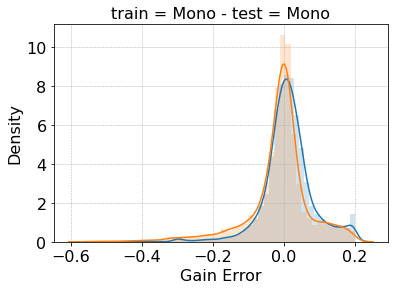

In [15]:
# histograms
steps_gain = [0.0, 0.1, 0.2, 0.5, 0.8, 1.0]
steps_tone = [0.0, 0.2, 0.5, 0.8, 1.0]
errors_gain = []
errors_tone = []

for n in range(len(steps_gain)):
    df = test_df_mono[test_df_mono['gain_targ'] == steps_gain[n]]
    errors_gain.append(df['gain_err'])
    
for n in range(len(steps_tone)):
    df = test_df_mono[test_df_mono['tone_eq1_targ'] == steps_tone[n]]
    errors_tone.append(df['tone_eq1_err'])

# plt.figure(figsize=(8,8))

sns.distplot(errors_gain[4], hist_kws=dict(alpha=0.2))
sns.distplot(errors_tone[3], hist_kws=dict(alpha=0.2))

plt.title('train = Mono - test = Mono', fontsize=16)

plt.xlabel('Gain Error', fontsize=16)
plt.ylabel('Density', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

# plt.legend(['Gain=[0.1,0.2)', 'Gain=[0.2,0.3)'])

# plt.xticks(np.linspace(start=0, stop=1, num=6))
# plt.plot([0, 1], [0, 0], 'k--', lw=1)

# plt.xlim([-0.05, 1.05])
# plt.ylim([-4, 4])

# TEST on MONO RANDOM

In [16]:
# dataset
dataset_mono_rnd = dataset.FxDataset(
                            root='/Volumes/Macintosh HD/DATASETS/GUITAR-FX/Mono_Random_Bg',
                            excl_folders=['MT2'], 
                            spectra_folder='mel_22050_1024_512', 
                            processed_settings_csv='proc_settings.csv',
                            max_num_settings=3,
                            transform=transforms.Compose([transforms.ToTensor()])
                            )

dataset_mono_rnd.init_dataset()
# dataset_mono_rnd.generate_mel()

# split
# set test_train_split=0.0 and val_train_split=0.0 to test pre-trained model
split_mono_rnd = datasplit.DataSplit(dataset_mono_rnd, test_train_split=0.0, val_train_split=0.0, shuffle=True)

# loaders
_, _, test_loader_mono_rnd = split_mono_rnd.get_split(batch_size=100)

len(dataset_mono_rnd)

130000

In [17]:
# test
test_mono_rnd_loss, test_mono_rnd_correct, test_mono_rnd_results = trainer.test_settings_cond_net(
        model=setnetcond, 
        test_loader=test_loader_mono_rnd, 
        test_sampler=split_mono_rnd.test_sampler,
        loss_function=nn.MSELoss(), 
        device='cpu'
    )

# example
test_mono_rnd_results[0]

====> Test Loss: 5.5334	 Avg Loss: 0.0000	Correct: 89131/130000	Percentage Correct: 68.56


(52443,
 'G61-49109-FFC-F1.9-20602',
 array([ 1.   ,  0.113, -1.   ], dtype=float32),
 array([ 1.  ,  0.19, -1.  ], dtype=float32))

In [18]:
# dataframe
test_results_npy_mono_rnd = np.array(test_mono_rnd_results)
test_indexes_mono_rnd = test_results_npy_mono_rnd[:, 0]
test_filenames_mono_rnd = test_results_npy_mono_rnd[:, 1] 
test_preds_mono_rnd = np.stack(test_results_npy_mono_rnd[:, 2])
test_targets_mono_rnd = np.stack(test_results_npy_mono_rnd[:, 3])
test_abs_err_mono_rnd = np.stack(abs(test_preds_mono_rnd - test_targets_mono_rnd))
test_err_mono_rnd = np.stack(test_preds_mono_rnd - test_targets_mono_rnd)

test_df_mono_rnd = pd.DataFrame(data={'index': test_indexes_mono_rnd, 
                                        'filename': test_filenames_mono_rnd,
                                        'level_pred': test_preds_mono_rnd[:,0], 
                                        'gain_pred': test_preds_mono_rnd[:,1],
                                        'tone_eq1_pred': test_preds_mono_rnd[:,2], 
                                        'level_targ': test_targets_mono_rnd[:,0], 
                                        'gain_targ': test_targets_mono_rnd[:,1],
                                        'tone_eq1_targ': test_targets_mono_rnd[:,2], 
                                        'level_err': test_err_mono_rnd[:,0], 
                                        'gain_err': test_err_mono_rnd[:,1],
                                        'tone_eq1_err': test_err_mono_rnd[:,2], 
                                        'level_abs': test_abs_err_mono_rnd[:,0], 
                                        'gain_abs': test_abs_err_mono_rnd[:,1],
                                        'tone_eq1_abs': test_abs_err_mono_rnd[:,2], 
                                        })
print(len(test_df_mono_rnd))
test_df_mono_rnd[:3]

130000


,index,filename,level_pred,gain_pred,tone_eq1_pred,level_targ,gain_targ,tone_eq1_targ,level_err,gain_err,tone_eq1_err,level_abs,gain_abs,tone_eq1_abs
0,52443,G61-49109-FFC-F1.9-20602,1.0,0.113,-1.000,1.0,0.19,-1.00,0.0,-0.077,0.000,0.0,0.077,0.000
1,115521,G63-48108-TS9-D3.7T0.1-20679,1.0,0.234,-0.009,1.0,0.37,0.01,0.0,-0.136,-0.019,0.0,0.136,0.019
2,20799,G63-62407-BMF-S9.5T4.1-20717,1.0,0.989,0.474,1.0,0.95,0.41,0.0,0.039,0.064,0.0,0.039,0.064


In [19]:
# Mean Absolute Errors
level_mae_mono_rnd = sum(test_df_mono_rnd.level_abs)/len(dataset_mono_rnd)
gain_mae_mono_rnd = sum(test_df_mono_rnd.gain_abs)/len(dataset_mono_rnd)
tone_eq1_mae_mono_rnd = sum(test_df_mono_rnd.tone_eq1_abs)/len(dataset_mono_rnd)

print('level_mae: ', level_mae_mono_rnd)
print('gain_mae: ', gain_mae_mono_rnd)
print('tone_eq1_mae: ', tone_eq1_mae_mono_rnd)

# Root Mean Squared Errors
level_rmse_mono_rnd = math.sqrt(sum(test_df_mono_rnd.level_abs**2)/len(dataset_mono_rnd))
gain_rmse_mono_rnd = math.sqrt(sum(test_df_mono_rnd.gain_abs**2)/len(dataset_mono_rnd))
tone_eq1_rmse_mono_rnd = math.sqrt(sum(test_df_mono_rnd.tone_eq1_abs**2)/len(dataset_mono_rnd))

print('level_rmse: ', level_rmse_mono_rnd)
print('gain_rmse: ', gain_rmse_mono_rnd)
print('tone_eq1_rmse: ', tone_eq1_rmse_mono_rnd)

level_mae:  0.0
gain_mae:  0.06401337646220524
tone_eq1_mae:  0.04419293052591742
level_rmse:  0.0
gain_rmse:  0.08424875989717266
tone_eq1_rmse:  0.07531292816711


[(-0.22, 0.22)]

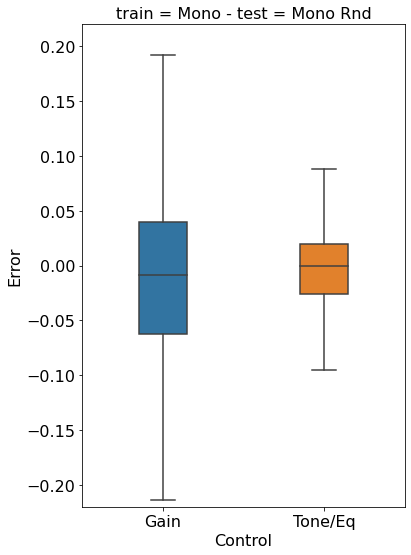

In [20]:
# box plot
err_df_mono_rnd = pd.DataFrame(data={
                        'Gain': test_df_mono_rnd['gain_err'],
                        'Tone/Eq': test_df_mono_rnd['tone_eq1_err'],
                        })

plt.figure(figsize=(6,8))

ax = sns.boxplot(x="variable", y="value", data=pd.melt(err_df_mono_rnd), width=0.3, showfliers = False, fliersize=2)

plt.title('train = Mono - test = Mono Rnd', fontsize=16)

plt.xlabel('Control', fontsize=16)
plt.ylabel('Error', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)
plt.rc('font', size=16) 

plt.tight_layout()
ax.set(ylim=(-0.22,0.22))
# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_mono_monornd_bp.eps'), format='eps')

<Figure size 576x576 with 0 Axes>

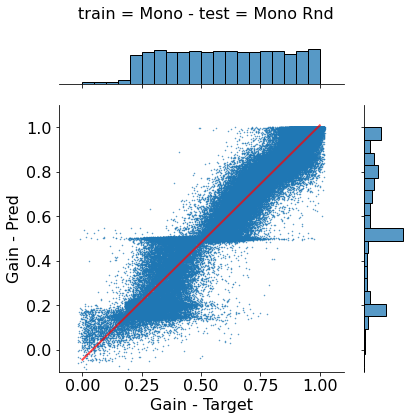

In [21]:
# scatter plot
plt.figure(figsize=(8,8))

ax = sns.jointplot(x="gain_targ", y="gain_pred", data=test_df_mono_rnd, marker='.', x_jitter=0.02, kind="reg", space=0.1,
                    scatter_kws={"s": 1}, 
                    line_kws={"color":"r","alpha":0.7,"lw":2},
                    marginal_kws=dict(kde=False, bins=20))

ax.fig.suptitle('train = Mono - test = Mono Rnd', fontsize=16)

plt.xlabel('Gain - Target', fontsize=16)
plt.ylabel('Gain - Pred', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

# plt.plot([0, 1], [0, 1], 'k:', lw=2)

ax.fig.tight_layout()
ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_mono_monornd_gain_sp.png'), format='png')

<Figure size 576x576 with 0 Axes>

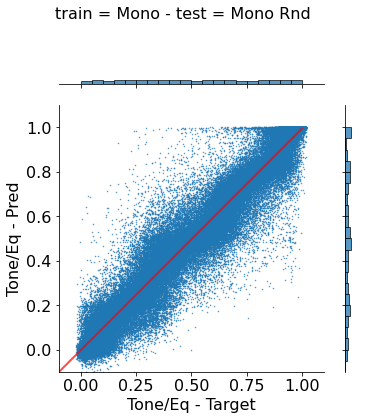

In [22]:
# scatter plot
plt.figure(figsize=(8,8))

ax = sns.jointplot(x="tone_eq1_targ", y="tone_eq1_pred", data=test_df_mono_rnd, marker='.', x_jitter=0.02, kind="reg", space=0.1,
                    scatter_kws={"s": 1}, 
                    line_kws={"color":"r","alpha":0.7,"lw":2},
                    marginal_kws=dict(kde=False, bins=40))

ax.fig.suptitle('train = Mono - test = Mono Rnd', fontsize=16)

plt.xlabel('Tone/Eq - Target', fontsize=16)
plt.ylabel('Tone/Eq - Pred', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

# plt.plot([0, 1], [0, 1], 'k:', lw=2)

ax.fig.tight_layout()
ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_mono_monornd_tone_sp.png'), format='png')

[ 0.043 -0.021 -0.037 -0.038  0.005 -0.031 -0.028  0.005  0.009  0.006]
[-0.006 -0.006 -0.008 -0.007 -0.008 -0.008 -0.012 -0.012 -0.008 -0.012]


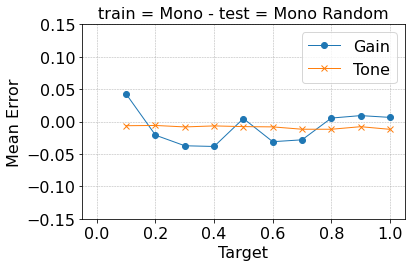

In [30]:
# mean error
step_size = 0.1
steps = np.linspace(start=0, stop=1, num=int(1/step_size + 1))
avg_err_gain = []
avg_err_tone = []

for n in range(len(steps)-1):
    df = test_df_mono_rnd[(test_df_mono_rnd['gain_targ'] >= steps[n]) & (test_df_mono_rnd['gain_targ'] < steps[n+1])]
    avg_err_gain.append(sum(df['gain_err']) / len(df))

for n in range(len(steps)-1):
    df = test_df_mono_rnd[(test_df_mono_rnd['tone_eq1_targ'] >= steps[n]) & (test_df_mono_rnd['tone_eq1_targ'] < steps[n+1])]
    avg_err_tone.append(sum(df['gain_err']) / len(df))

print(np.around(avg_err_gain,3))
print(np.around(avg_err_tone,3))

plt.plot(steps[1:], avg_err_gain, linestyle='-', linewidth=1, marker='o')
plt.plot(steps[1:], avg_err_tone, linestyle='-', linewidth=1, marker='x')

plt.title('train = Mono - test = Mono Random', fontsize=16)

plt.xlabel('Target', fontsize=16)
plt.ylabel('Mean Error', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

plt.legend(['Gain', 'Tone'])

plt.xticks(np.linspace(start=0, stop=1, num=6))
# plt.plot([0, 1], [0, 0], 'k--', lw=1)

plt.xlim([-0.05, 1.05])
plt.ylim([-0.15, 0.15])

plt.tight_layout()
# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_mono_monornd_me.eps'), format='eps')

[ 1.598  2.077  1.879  0.387 -1.642 -0.817 -0.084 -0.817 -0.216 -1.424]
[ 1.762  1.063  1.405  0.231  0.44   0.862 -0.042 -1.045 -1.032 -2.437]


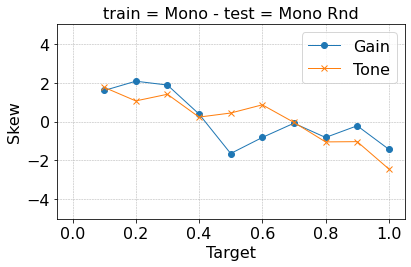

In [32]:
# skew
step_size = 0.1
steps = np.linspace(start=0, stop=1, num=int(1/step_size + 1))
skew_gain = []
skew_tone = []

for n in range(len(steps)-1):
    df = test_df_mono_rnd[(test_df_mono_rnd['gain_targ'] >= steps[n]) & (test_df_mono_rnd['gain_targ'] < steps[n+1])]
    skew_gain.append(scipy.stats.skew(df['gain_err']))

for n in range(len(steps)-1):
    df = test_df_mono_rnd[(test_df_mono_rnd['tone_eq1_targ'] >= steps[n]) & (test_df_mono_rnd['tone_eq1_targ'] < steps[n+1])]
    skew_tone.append(scipy.stats.skew(df['tone_eq1_err']))

print(np.around(skew_gain,3))
print(np.around(skew_tone,3))

plt.plot(steps[1:], skew_gain, linestyle='-', linewidth=1, marker='o')
plt.plot(steps[1:], skew_tone, linestyle='-', linewidth=1, marker='x')

plt.title('train = Mono - test = Mono Rnd', fontsize=16)

plt.xlabel('Target', fontsize=16)
plt.ylabel('Skew', fontsize=16)

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)

plt.rc('font', size=16) 

plt.rc('grid', linestyle="--", linewidth=0.5)
plt.grid()

plt.legend(['Gain', 'Tone'])

plt.xticks(np.linspace(start=0, stop=1, num=6))

plt.xlim([-0.05, 1.05])
plt.ylim([-5, 5])

plt.tight_layout()
plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnet_mono_monornd_sk.eps'), format='eps')

# TEST on POLY

In [25]:
# # dataset
# dataset_poly = dataset.FxDataset(
#                             root='/Volumes/Macintosh HD/DATASETS/GUITAR-FX/Poly',
#                             excl_folders=['MT2'], 
#                             spectra_folder='mel_22050_1024_512', 
#                             processed_settings_csv='proc_settings.csv',
#                             max_num_settings=3,
#                             transform=transforms.Compose([transforms.ToTensor()])
#                             )

# dataset_poly.init_dataset()
# # dataset_mono_rnd.generate_mel()

# # split
# # set test_train_split=0.0 and val_train_split=0.0 to test pre-trained model
# split_poly = datasplit.DataSplit(dataset_poly, test_train_split=0.0, val_train_split=0.0, shuffle=True)

# # loaders
# _, _, test_loader_poly = split_poly.get_split(batch_size=100)

# len(dataset_poly)

In [26]:
# # test
# test_poly_loss, test_poly_correct, test_poly_results = trainer.test_settings_cond_net(
#         model=setnetcond, 
#         test_loader=test_loader_poly, 
#         test_sampler=split_poly.test_sampler,
#         loss_function=nn.MSELoss(), 
#         device='cpu'
#     )

# TEST on POLY RANDOM

In [27]:
# # dataset
# dataset_poly_rnd = dataset.FxDataset(
#                             root='/Volumes/Macintosh HD/DATASETS/GUITAR-FX/Poly_Random_Bg',
#                             excl_folders=['NoFX_poly', 'MT2'], 
#                             spectra_folder='mel_22050_1024_512', 
#                             processed_settings_csv='proc_settings.csv',
#                             max_num_settings=3,
#                             transform=transforms.Compose([transforms.ToTensor()])
#                             )

# dataset_poly_rnd.init_dataset()
# # dataset_mono_rnd.generate_mel()

# # split
# # set test_train_split=0.0 and val_train_split=0.0 to test pre-trained model
# split_poly_rnd = datasplit.DataSplit(dataset_poly_rnd, test_train_split=0.0, val_train_split=0.0, shuffle=True)

# # loaders
# _, _, test_loader_poly_rnd = split_poly_rnd.get_split(batch_size=100)

# len(dataset_poly_rnd)

In [28]:
# # test
# test_poly_rnd_loss, test_poly_rnd_correct, test_poly_rnd_results = trainer.test_settings_cond_net(
#         model=setnetcond, 
#         test_loader=test_loader_poly_rnd, 
#         test_sampler=split_poly_rnd.test_sampler,
#         loss_function=nn.MSELoss(), 
#         device='cpu'
#     )